# **What is Transfer Learning?**
**Transfer learning is the reuse of a pre-trained model on a new problem. It’s currently very popular in deep learning because it can train deep neural networks with comparatively little data. This is very useful in the data science field since most real-world problems typically do not have millions of labeled data points to train such complex models.**

TensorFlow Hub is an open repository and library for reusable machine learning. The tfhub.dev repository provides many pre-trained models: text embeddings, image classification models, TF.js/TFLite models and much more. The repository is open to community contributors.

The tensorflow_hub library lets you download and reuse them in your TensorFlow program with a minimum amount of code.

In [17]:
pip install tensorflow_hub

Note: you may need to restart the kernel to use updated packages.


In [18]:
import numpy as np
import PIL.Image as Image
import cv2
import os
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow import keras
from tensorflow.keras import layers , Sequential

In [19]:
batch_size = 32

In [20]:
image_shape = (224,224)
classifier = tf.keras.Sequential([
    hub.KerasLayer("https://tfhub.dev/google/tf2-preview/mobilenet_v2/classification/4" , input_shape = image_shape+(3,))
])

In [21]:
image_shape+(3,)

(224, 224, 3)

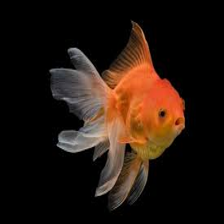

In [22]:
gold_fish = Image.open("/kaggle/input/gold-fish1/download.jpeg").resize(image_shape)
gold_fish

In [23]:
gold_fish1 = np.array(gold_fish)/256
gold_fish1

array([[[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       ...,

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]]])

In [24]:
gold_fish1[np.newaxis,...].shape # adding a new dimension because prediction model takes a batch of images.


(1, 224, 224, 3)

In [25]:
answer = classifier.predict(gold_fish1[np.newaxis,...])

1/1 [==============================] - 0s 454ms/step


In [26]:
np.argmax(answer)

2

In [27]:
answer.shape

(1, 1001)

In [28]:
import pathlib
data_dir = pathlib.Path("/kaggle/input/plant-village/PlantVillage")
data_dir

PosixPath('/kaggle/input/plant-village/PlantVillage')

In [29]:
list(data_dir.glob("*/*"))[:5]

[PosixPath('/kaggle/input/plant-village/PlantVillage/Pepper__bell___Bacterial_spot/0f72db9c-d635-4415-9781-68937328aed2___NREC_B.Spot 9188.JPG'),
 PosixPath('/kaggle/input/plant-village/PlantVillage/Pepper__bell___Bacterial_spot/1b8d3e98-43d9-441d-93ef-a359e6e9ddc2___NREC_B.Spot 9052.JPG'),
 PosixPath('/kaggle/input/plant-village/PlantVillage/Pepper__bell___Bacterial_spot/b6d35d21-4812-4e32-ab9a-b6ddda8cbb79___JR_B.Spot 8972.JPG'),
 PosixPath('/kaggle/input/plant-village/PlantVillage/Pepper__bell___Bacterial_spot/e4e7e5a2-5aa1-4378-833d-9142358c7c9b___JR_B.Spot 9092.JPG'),
 PosixPath('/kaggle/input/plant-village/PlantVillage/Pepper__bell___Bacterial_spot/8b50f2db-cbf2-4758-bea6-a011f0cc1497___JR_B.Spot 3235.JPG')]

In [30]:
image_count=len(list(data_dir.glob("Pepper__bell___Bacterial_spot/*")))
image_count

997

# Creating a Dataset

In [31]:
dataset = tf.keras.preprocessing.image_dataset_from_directory("/kaggle/input/plant-village/PlantVillage", image_size =image_shape)

class_names = dataset.class_names

Found 20638 files belonging to 15 classes.


In [32]:
!pip install split-folders

In [63]:
# splitting folders for training, validation and test.
# we would be using validation data for training and test data for cross validation because we took a
# pretrained model and need a little data to make it work.
import splitfolders
splitfolders.ratio("/kaggle/input/plant-village/PlantVillage", output="/kaggle/working/",
     ratio=(.7, .2, .1))

Copying files: 20639 files [00:50, 407.71 files/s] 


In [52]:
classes_wise_plant_images = {}
classes_labels_for_images = {}
x=0
for class_name in class_names:
    x =x
    classes_wise_plant_images[class_name] = list(data_dir.glob(f"{class_name}/*"))
    classes_labels_for_images[class_name] = x
    x = x+1
    

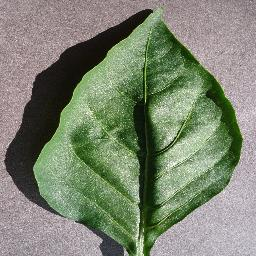

In [53]:
Image.open(classes_wise_plant_images["Pepper__bell___healthy"][0])

In [54]:
classes_labels_for_images

{'Pepper__bell___Bacterial_spot': 0,
 'Pepper__bell___healthy': 1,
 'Potato___Early_blight': 2,
 'Potato___Late_blight': 3,
 'Potato___healthy': 4,
 'Tomato_Bacterial_spot': 5,
 'Tomato_Early_blight': 6,
 'Tomato_Late_blight': 7,
 'Tomato_Leaf_Mold': 8,
 'Tomato_Septoria_leaf_spot': 9,
 'Tomato_Spider_mites_Two_spotted_spider_mite': 10,
 'Tomato__Target_Spot': 11,
 'Tomato__Tomato_YellowLeaf__Curl_Virus': 12,
 'Tomato__Tomato_mosaic_virus': 13,
 'Tomato_healthy': 14}

In [55]:
image = cv2.imread(str(classes_wise_plant_images["Pepper__bell___healthy"][0]))
image

array([[[173, 170, 185],
        [153, 150, 165],
        [156, 153, 168],
        ...,
        [137, 133, 145],
        [149, 145, 157],
        [133, 129, 141]],

       [[153, 150, 165],
        [166, 163, 178],
        [136, 133, 148],
        ...,
        [115, 111, 123],
        [140, 136, 148],
        [139, 135, 147]],

       [[135, 132, 147],
        [158, 155, 170],
        [148, 145, 160],
        ...,
        [133, 129, 141],
        [155, 151, 163],
        [137, 133, 145]],

       ...,

       [[169, 163, 174],
        [153, 147, 158],
        [135, 129, 140],
        ...,
        [215, 208, 211],
        [200, 193, 196],
        [190, 183, 186]],

       [[148, 142, 153],
        [142, 136, 147],
        [204, 198, 209],
        ...,
        [184, 177, 180],
        [187, 180, 183],
        [206, 199, 202]],

       [[161, 155, 166],
        [157, 151, 162],
        [144, 138, 149],
        ...,
        [193, 186, 189],
        [182, 175, 178],
        [191, 184, 187]]

In [56]:
cv2.resize(image,image_shape)

array([[[170, 167, 182],
        [154, 151, 166],
        [149, 146, 160],
        ...,
        [121, 117, 129],
        [145, 142, 153],
        [134, 130, 142]],

       [[150, 147, 162],
        [159, 156, 171],
        [142, 139, 154],
        ...,
        [121, 117, 129],
        [138, 134, 146],
        [139, 135, 147]],

       [[137, 134, 149],
        [155, 152, 167],
        [149, 146, 161],
        ...,
        [134, 130, 142],
        [143, 139, 151],
        [131, 127, 139]],

       ...,

       [[161, 155, 166],
        [150, 144, 155],
        [165, 158, 170],
        ...,
        [199, 192, 196],
        [198, 191, 194],
        [189, 182, 185]],

       [[152, 146, 157],
        [154, 148, 159],
        [177, 171, 182],
        ...,
        [188, 181, 184],
        [190, 183, 186],
        [202, 195, 198]],

       [[160, 154, 165],
        [154, 148, 159],
        [146, 140, 151],
        ...,
        [194, 187, 190],
        [184, 177, 180],
        [191, 184, 187]]

In [57]:
# training data 
train_ds = tf.keras.preprocessing.image_dataset_from_directory("/kaggle/working/val",
                                                              shuffle=True,
                                                               batch_size=batch_size)

Found 4122 files belonging to 15 classes.


In [58]:
# Validation data
val_ds = tf.keras.preprocessing.image_dataset_from_directory("/kaggle/working/test",
                                                              shuffle=True,
                                                               batch_size=batch_size)

Found 2076 files belonging to 15 classes.


In [64]:
# As the requirement of the model is that image must be of size 224,224.
# And rescale the image to make algorithm run faster.
resize_and_rescale = tf.keras.Sequential([
    layers.experimental.preprocessing.Resizing(224,224),
    layers.experimental.preprocessing.Rescaling(1.0/255)
])

**Here we are using the hidden layers of the pretrained without the output layer.**

In [60]:
feature_extractor_model = "https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4"
pretrained_model_without_top_layer = hub.KerasLayer(feature_extractor_model, input_shape=(224,224,3), trainable = False)

In [61]:
model = tf.keras.Sequential([
    resize_and_rescale,
    pretrained_model_without_top_layer,
    tf.keras.layers.Dense(len(class_names))
    
])

In [62]:
model.compile(optimizer = "adam" , 
              loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits = True), 
              metrics = ["accuracy"])


In [45]:
history = model.fit(train_ds,epochs=10,batch_size=batch_size,verbose=1 , validation_data=val_ds)

Epoch 1/10
129/129 [==============================] - 15s 77ms/step - loss: 1.2234 - accuracy: 0.6601 - val_loss: 0.6721 - val_accuracy: 0.8194
Epoch 2/10
129/129 [==============================] - 9s 65ms/step - loss: 0.5427 - accuracy: 0.8549 - val_loss: 0.4995 - val_accuracy: 0.8565
Epoch 3/10
129/129 [==============================] - 9s 66ms/step - loss: 0.4013 - accuracy: 0.8937 - val_loss: 0.4170 - val_accuracy: 0.8829
Epoch 4/10
129/129 [==============================] - 9s 66ms/step - loss: 0.3259 - accuracy: 0.9173 - val_loss: 0.3803 - val_accuracy: 0.8858
Epoch 5/10
129/129 [==============================] - 9s 66ms/step - loss: 0.2753 - accuracy: 0.9323 - val_loss: 0.3522 - val_accuracy: 0.8969
Epoch 6/10
129/129 [==============================] - 9s 69ms/step - loss: 0.2360 - accuracy: 0.9430 - val_loss: 0.3342 - val_accuracy: 0.8984
Epoch 7/10
129/129 [==============================] - 9s 65ms/step - loss: 0.2059 - accuracy: 0.9537 - val_loss: 0.3211 - val_accuracy: 0.898

In [46]:
data_set= tf.keras.preprocessing.image_dataset_from_directory("/kaggle/working/train",
                                                              shuffle=True,
                                                               batch_size=batch_size)

Found 14440 files belonging to 15 classes.


In [47]:
test_data = data_set.take(1)


In [48]:
scores = model.evaluate(test_data)

1/1 [==============================] - 0s 281ms/step - loss: 0.3737 - accuracy: 0.8438


In [49]:
def predict_using_model (model, image):
    image_array = tf.keras.preprocessing.image.img_to_array(images[i].numpy())
    image_array = tf.expand_dims(image_array , 0)
    prediction = model.predict(image_array)
    predicted_class = class_names[np.argmax(prediction[0])]
    confidence = round(100*(np.max(prediction[0])),2)
    return predicted_class , confidence

1/1 [==============================] - 0s 24ms/step


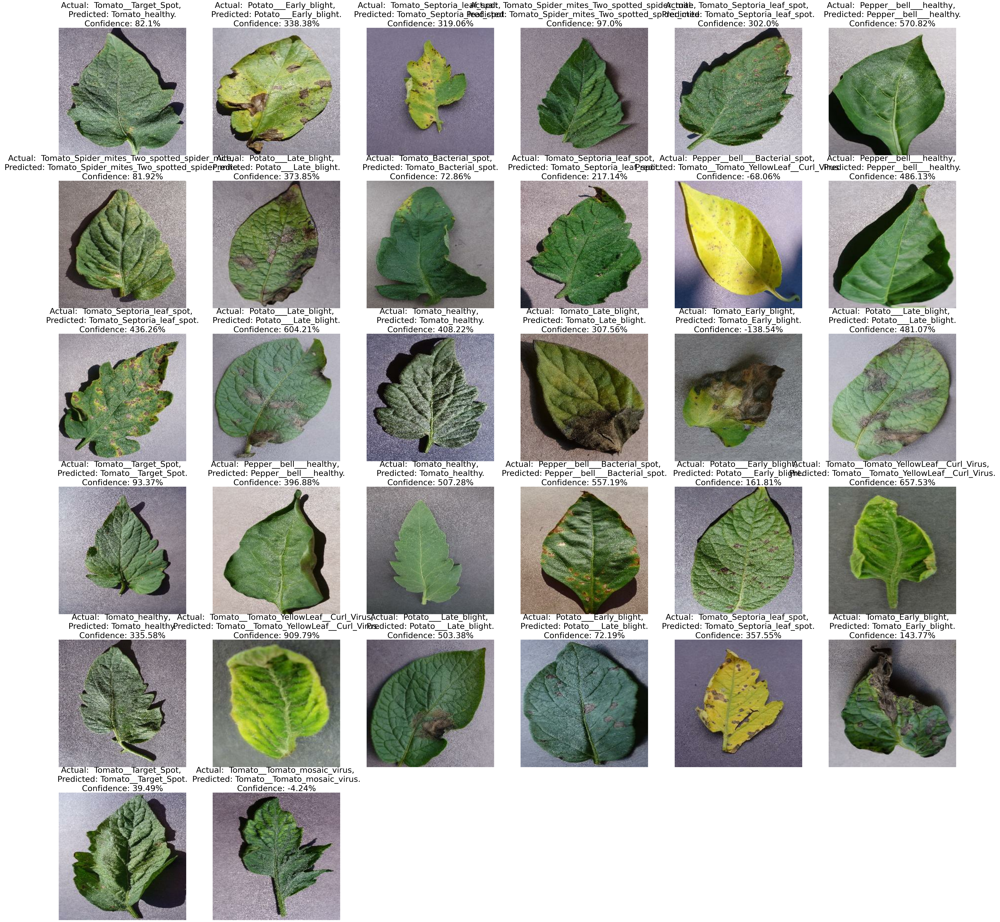

In [50]:

plt.figure(figsize = (60,60))
for images , labels in test_data.take(1):
    for i in range(batch_size):
        ax = plt.subplot(6,6,i+1)
        plt.imshow(images[i].numpy().astype("uint8"))
        predicted_class , confidence = predict_using_model(model , images[i].numpy())
        actual_class = class_names[labels[i]]
        plt.title(f"Actual:  {actual_class}, \n Predicted: {predicted_class}. \n Confidence: {confidence}% ", fontsize = 30)
        plt.axis("off")

In [51]:
model.save("/kaggle/working/plant_model_v1")